In [51]:
import sys
sys.path.append('../')
import cv2  
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import MeanShift, estimate_bandwidth

# Изменим стандартный размер графиков matplotlib
WIDTH_SIZE = 15
HEIGHT_SIZE = 10
plt.rcParams["figure.figsize"] = [WIDTH_SIZE, HEIGHT_SIZE]

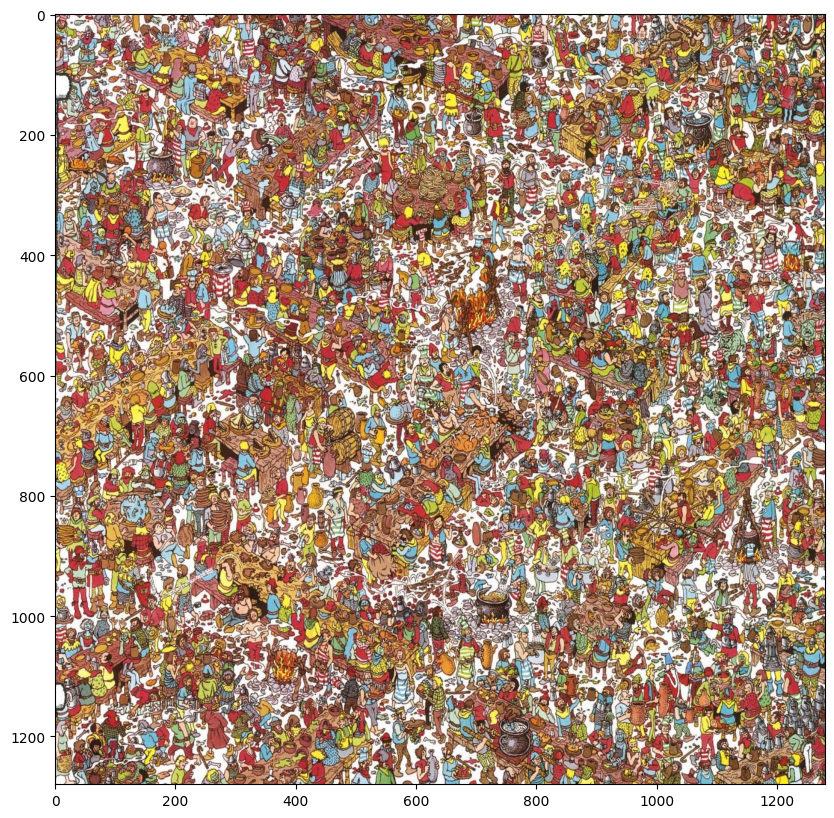

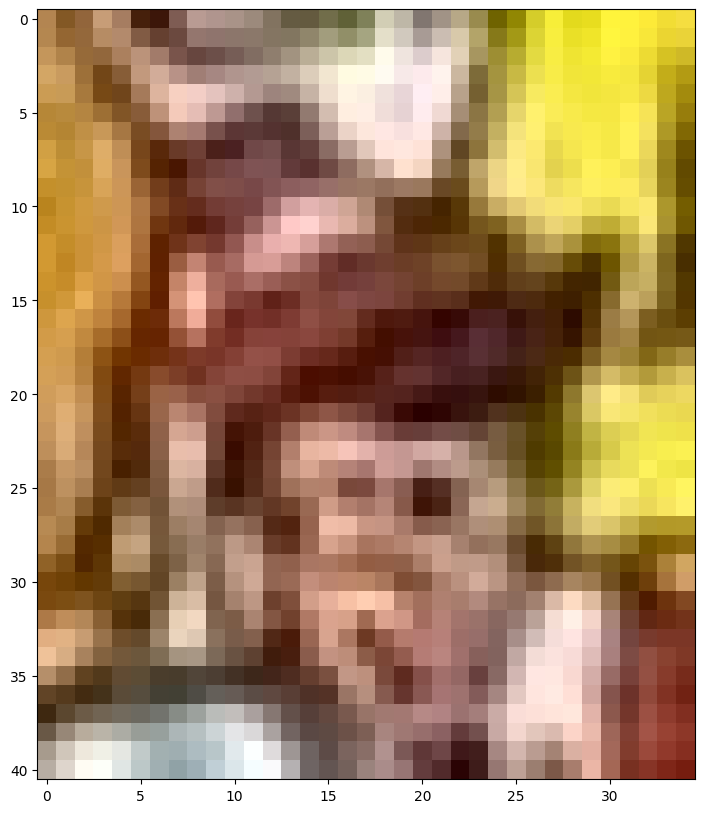

In [52]:
# Загружаем изображение
brg_scene = cv2.imread('../images/scene.jpg') 
plt.figure()
plt.imshow(cv2.cvtColor(brg_scene, cv2.COLOR_BGR2RGB))
# Преобразуем изображение в оттенки серого 
gray_img_scene = cv2.cvtColor(brg_scene, cv2.COLOR_BGR2GRAY)

# Загружаем шаблон  
template_brg = cv2.imread('../images/pattern.jpg')
plt.figure()
plt.imshow(cv2.cvtColor(template_brg, cv2.COLOR_BGR2RGB))

# Преобразуем в оттенки серого
gray_templ = cv2.cvtColor(template_brg, cv2.COLOR_BGR2GRAY)  




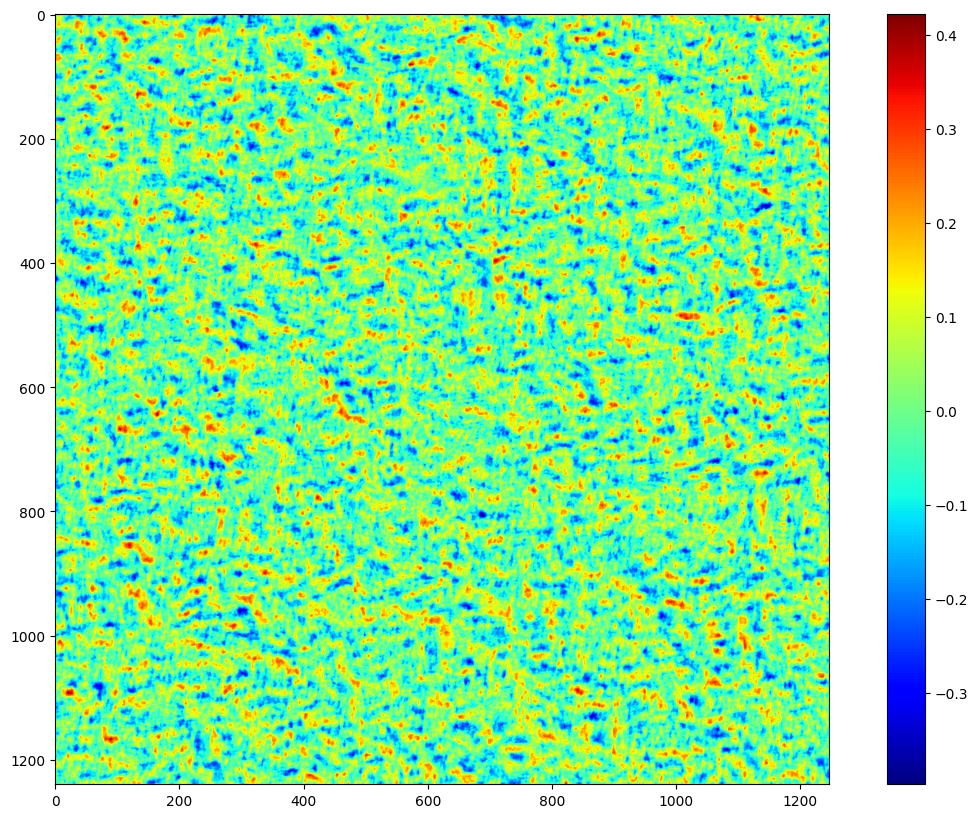

In [53]:
# Считаем размеры шаблона
w, h = template_brg.shape[:-1] 
 
# Вызываем функцию cv2.matchTemplate для вычисления метрики схожести
# в качестве параметров передаем изображение, шаблон и тип вычисляемой метрики
res = cv2.matchTemplate(gray_img_scene,gray_templ,cv2.TM_CCOEFF_NORMED)  

# Возможные варианты метрик:
#    cv2.TM_SQDIFF — сумма квадратов разниц значений пикселей
#    cv2.TM_SQDIFF_NORMED — сумма квадрат разниц цветов, отнормированная в диапазон 0..1.
#    cv2.TM_CCORR — сумма поэлементных произведений шаблона и сегмента картинки
#    cv2.TM_CCORR_NORMED — сумма поэлементных произведений, отнормированное в диапазон -1..1.
#    cv2.TM_CCOEFF — кросс-коррелация изображений без среднего
#    cv2.TM_CCOEFF_NORMED — кросс-корреляция между изображениями без среднего, отнормированная в -1..1 (корреляция Пирсона)
plt.figure()
plt.imshow(res, cmap='jet')
plt.colorbar()

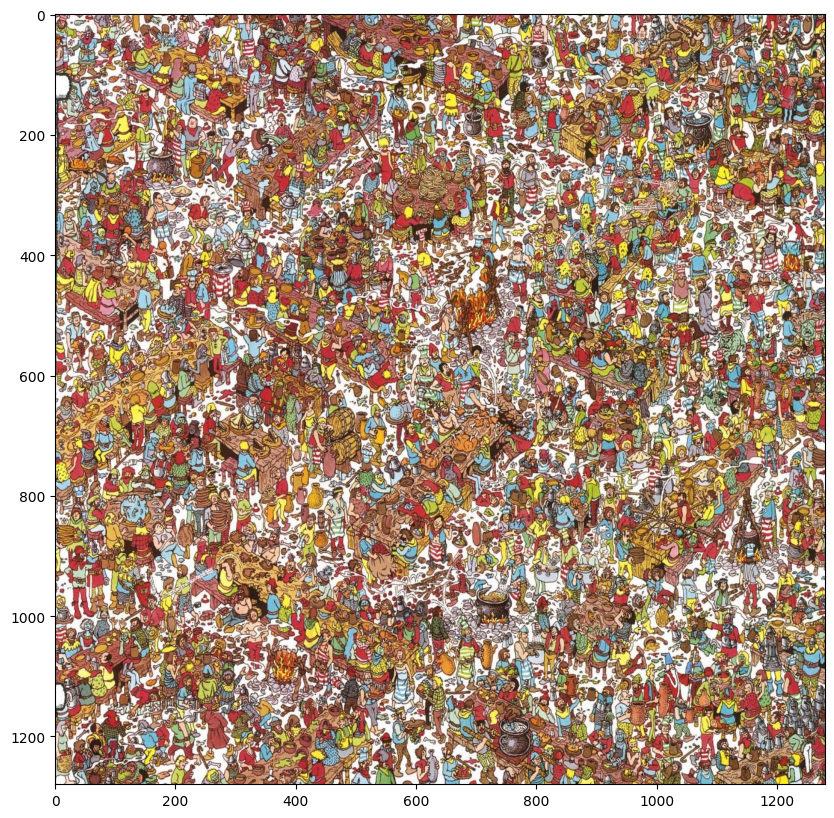

In [54]:
threshold = 0.8
loc = np.where(res >= threshold) 
# Вокруг выделенных максимумов обводим прямоугольники с размерами шаблона
plot_img = brg_scene.copy()
for pt in zip(*loc[::-1]):
    cv2.rectangle(plot_img, pt,(pt[0] + w, pt[1] + h),(173,255,47), 8)  

# Отображаем результат на графике
plt.figure()
plt.imshow(cv2.cvtColor(plot_img, cv2.COLOR_BGR2RGB))

(Text(0.5, 1.0, 'Sobel'), ([], []), ([], []))

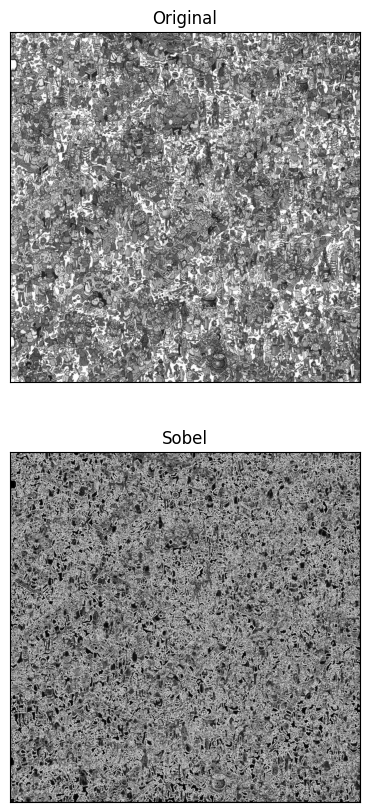

In [55]:
imgG = cv2.cvtColor(brg_scene, cv2.COLOR_BGR2GRAY)



x = cv2.Sobel(imgG,cv2.CV_16S,1,0)  
y = cv2.Sobel(imgG,cv2.CV_16S,0,1)  

# берем модуль от результата применения фильтра Собеля
absX = cv2.convertScaleAbs(x)
absY = cv2.convertScaleAbs(y)  
  
# объединяем "вертикальные" и "горизонтальные" границы в одно изображение
dstI = cv2.addWeighted(absX,0.5,absY,0.5,0)
plt.figure()
plt.subplot(2,1,1),plt.imshow(imgG,cmap = 'gray')
plt.title('Original'), plt.xticks([]), plt.yticks([])
plt.subplot(2,1,2),plt.imshow(dstI,cmap = 'gray')
plt.title('Sobel'), plt.xticks([]), plt.yticks([])

(Text(0.5, 1.0, 'Sobel'), ([], []), ([], []))

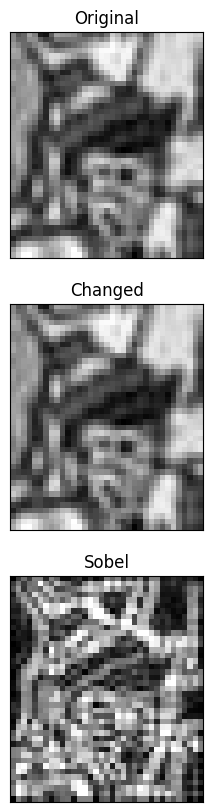

In [56]:
tmpG = gray_templ
x = cv2.Sobel(tmpG,cv2.CV_16S,1,0)  
y = cv2.Sobel(tmpG,cv2.CV_16S,0,1)  
absX = cv2.convertScaleAbs(x)
absY = cv2.convertScaleAbs(y)  
dstT = cv2.addWeighted(absX,0.5,absY,0.5,0)

plt.subplot(3,1,1),plt.imshow(gray_templ,cmap = 'gray')
plt.title('Original'), plt.xticks([]), plt.yticks([])
plt.subplot(3,1,2),plt.imshow(tmpG,cmap = 'gray')
plt.title('Changed'), plt.xticks([]), plt.yticks([])
plt.subplot(3,1,3),plt.imshow(dstT,cmap = 'gray')
plt.title('Sobel'), plt.xticks([]), plt.yticks([])

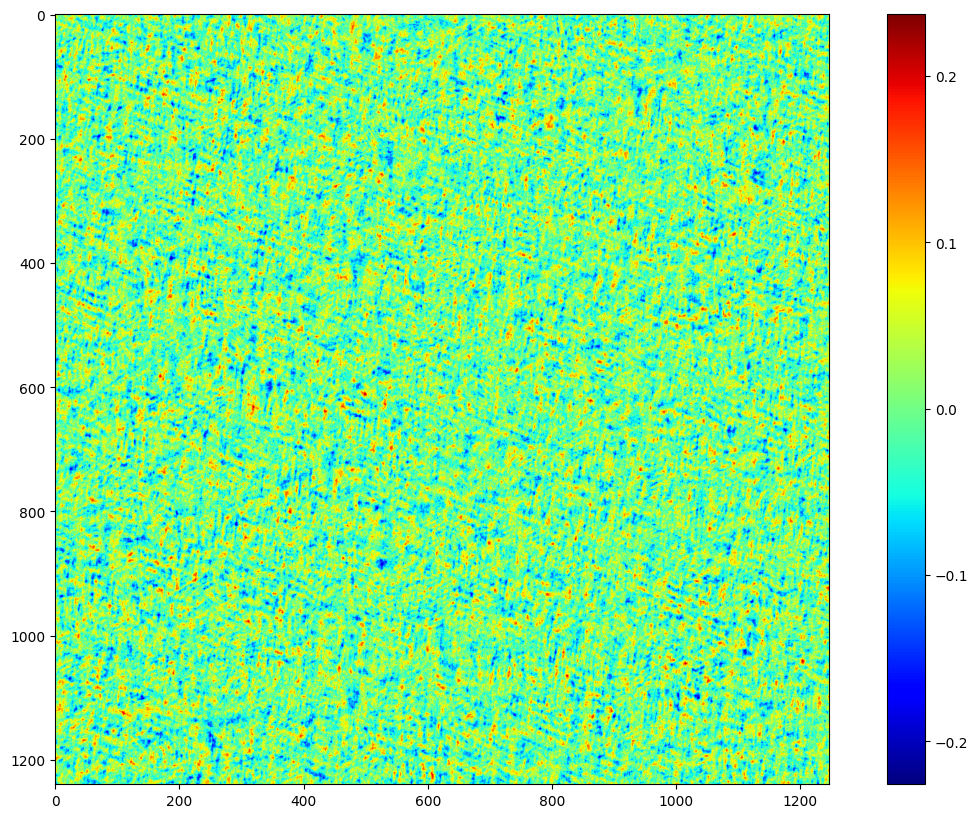

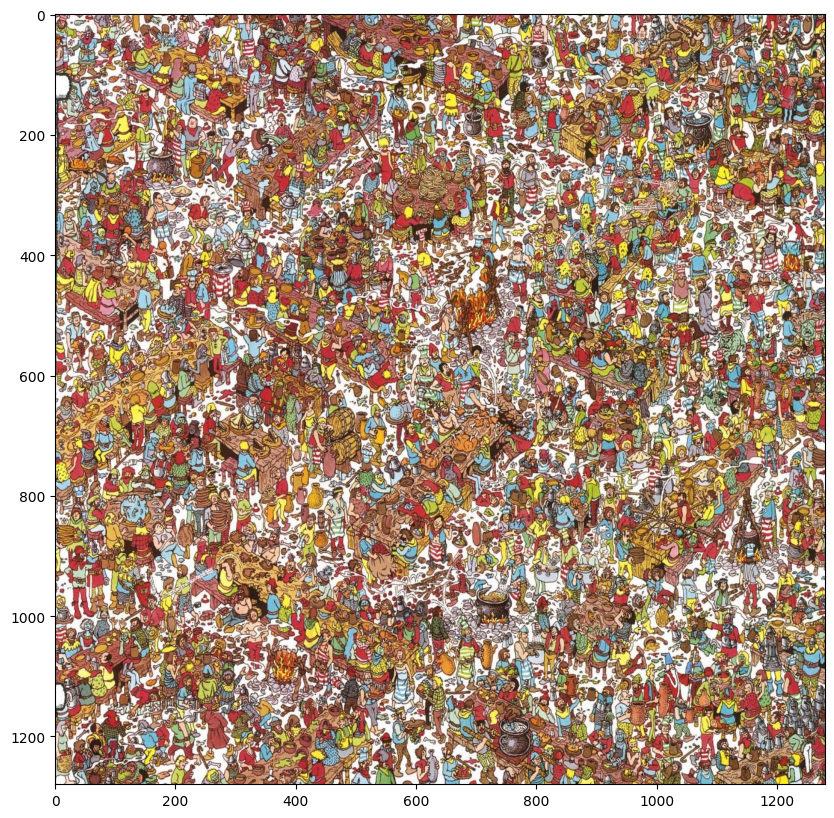

In [57]:
w, h = tmpG.shape
  
# Вычисляем метрику схожести  
res = cv2.matchTemplate(dstI,dstT,cv2.TM_CCOEFF_NORMED)  
plt.figure(figsize=(WIDTH_SIZE,HEIGHT_SIZE))
plt.imshow(res, cmap='jet')
plt.colorbar()

#  Отбираем максимумы и строим результат на графике
threshold = 0.7
loc = np.where(res >= threshold)  
plot_img = brg_scene.copy()
for pt in zip(*loc[::-1]):
    cv2.rectangle(plot_img, pt,(pt[0] + w, pt[1] + h),(173,255,47), 8)  

plt.figure(figsize=(WIDTH_SIZE,HEIGHT_SIZE))
plt.imshow(cv2.cvtColor(plot_img, cv2.COLOR_BGR2RGB))

(2.330155849456787, 646.5916748046875)
1.8757448196411133
2.8094482421875
0.055227186530828476
1.8757448196411133


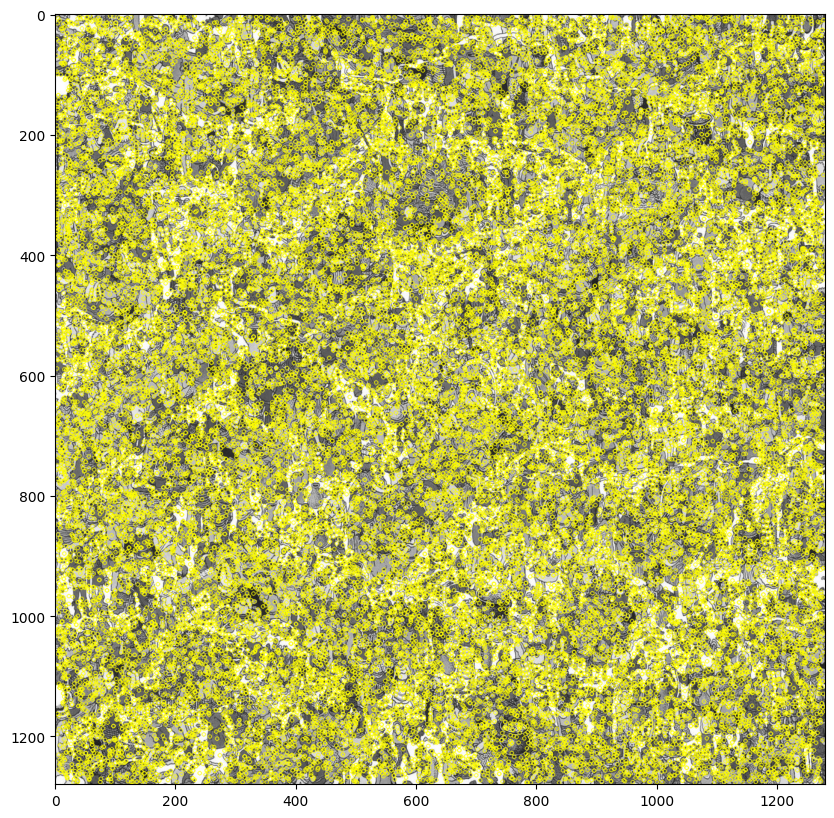

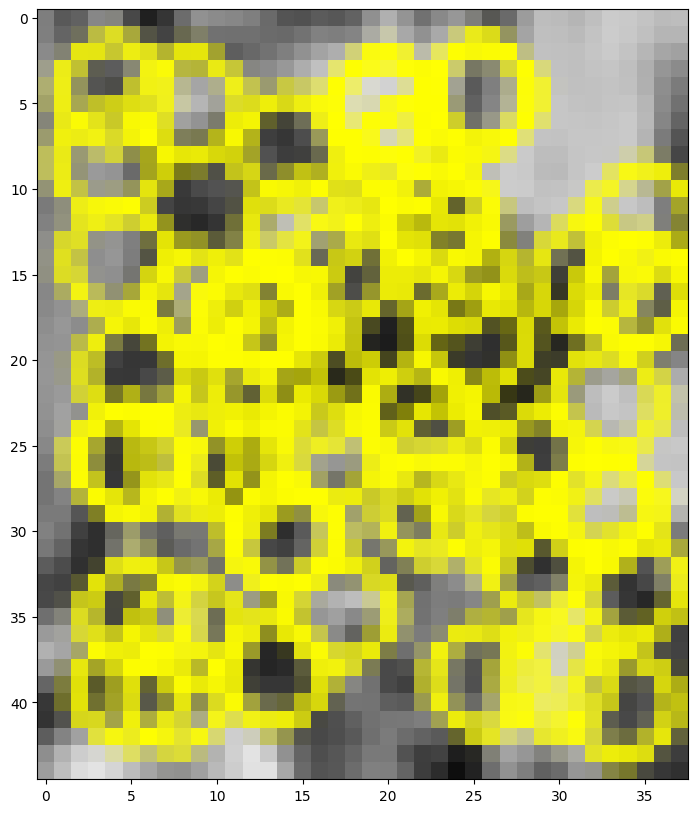

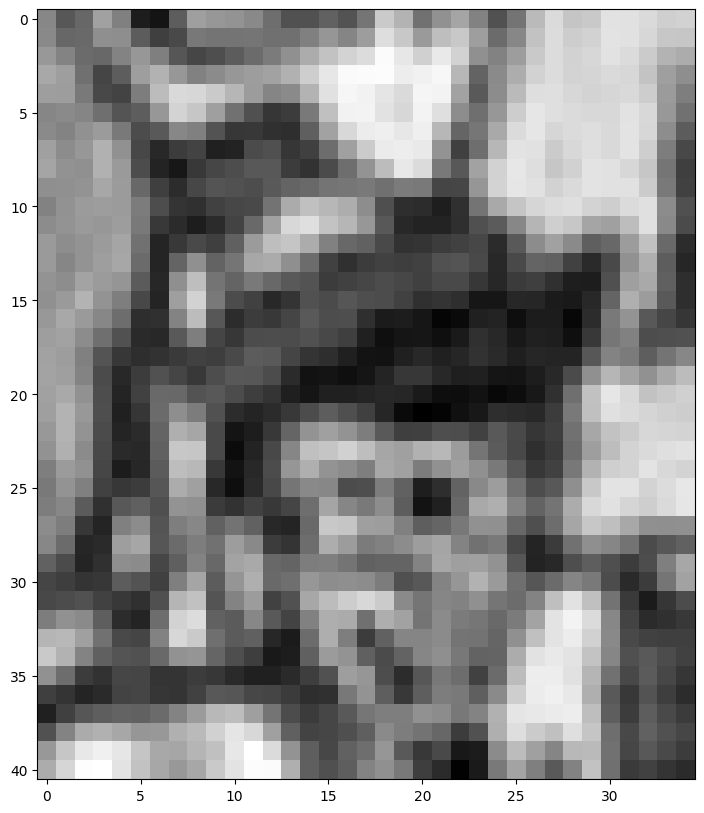

In [58]:
# Преобразуем и вносим небольшие изменения в шаблон

    # Преобразуем в оттенки серого
scale = 1.1 # масштаб изменения размеров
scBr = 0.9 # коэффициент изменения яркости

template_scale = cv2.resize(np.uint8(0.9*gray_templ),
           (int(gray_templ.shape[1]*scale), int(gray_templ.shape[0]*scale)), interpolation = cv2.INTER_AREA)

# Создаем детектор особых точек
sift = cv2.SIFT_create()
# sift = cv2.xfeatures2d.SIFT_create() # В зависимости от версии opencv может работать эта команда

# Запускаем детектор на изображении и на шаблоне
# Метод возвращает список особых точек и их дескрипторов
k_1, des_1 = sift.detectAndCompute(gray_img_scene, None)
k_2, des_2 = sift.detectAndCompute(template_scale, None)

# Каждая особая точка имеет несколько параметров, таких как координаты, 
# размер, угол ориентации, мощность отклика и размер области особой точки.
print(k_1[1].pt)
print(k_1[1].size)
print(k_1[1].angle)
print(k_1[1].response)
print(k_1[1].size)

# Отрисуем найденные точки на картинке
image_key_point = cv2.drawKeypoints(gray_img_scene, k_1, des_1, (0, 255, 255))
plt.figure()
plt.imshow(cv2.cvtColor(image_key_point, cv2.COLOR_BGR2RGB))

# Отрисуем найденные точки на шаблоне
template_key_point = cv2.drawKeypoints(template_scale, k_2, des_2, (0, 255, 255))
plt.figure()
plt.imshow(cv2.cvtColor(template_key_point, cv2.COLOR_BGR2RGB))

plt.figure()
plt.imshow(gray_templ, cmap="gray")

In [59]:
bf = cv2.BFMatcher(cv2.NORM_L1, crossCheck=True)


matches = bf.match(des_1, des_2)

print(matches[1].queryIdx)
print(matches[1].trainIdx)
print(matches[1].distance)

374
2
1286.0


3.920422315597534


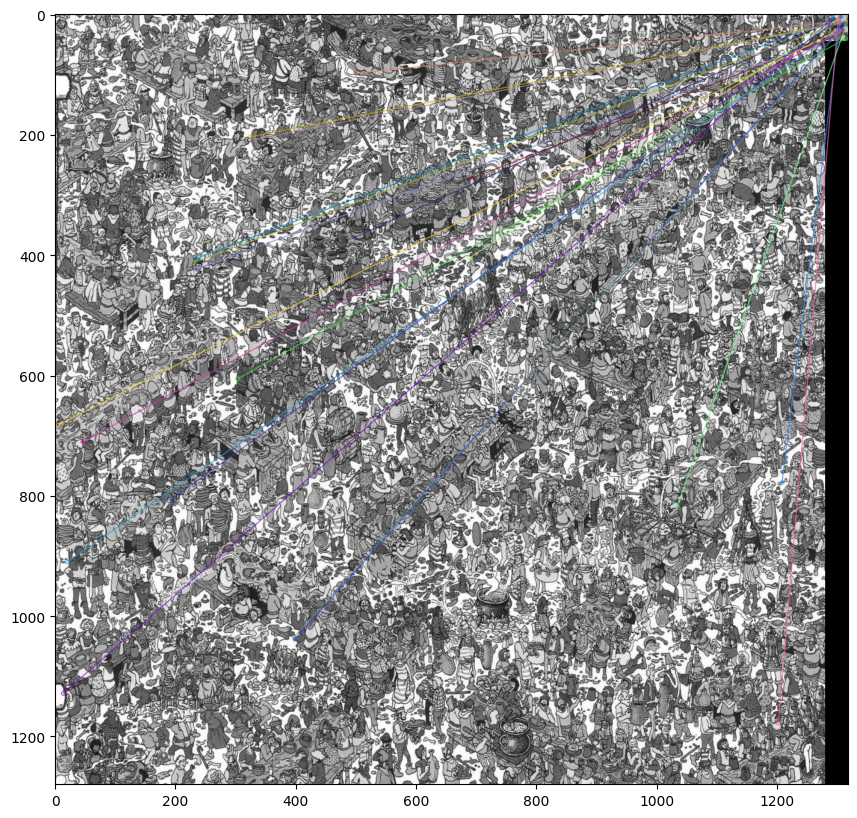

In [60]:
print(k_1[matches[1].queryIdx].size)
matches = sorted(matches, key=lambda x: x.distance)
image_with_matches = cv2.drawMatches(gray_img_scene, k_1, template_scale, k_2, matches[:20], template_scale, flags=2)
plt.figure()
plt.imshow(cv2.cvtColor(image_with_matches, cv2.COLOR_BGR2RGB))

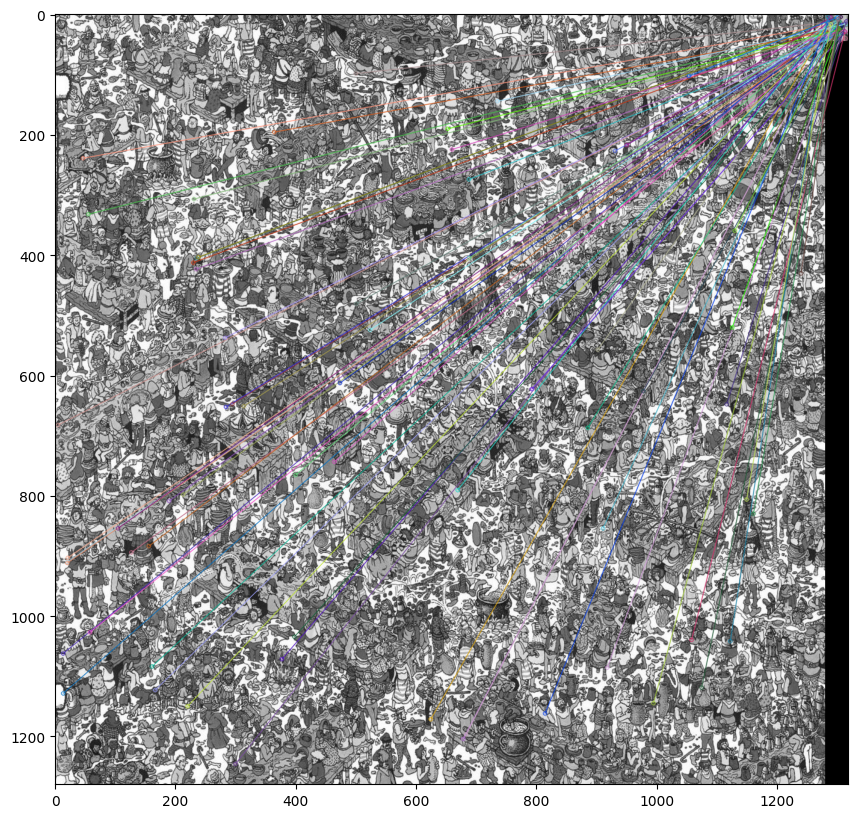

In [61]:
bf = cv2.BFMatcher(cv2.NORM_L1)
matches = bf.knnMatch(des_1, des_2, k=2)

# Лучшие пары особых точек отбираются с использованием теста отношения правдоподобия
good = []
for m, n in matches:
    if m.distance < 0.7 * n.distance:
        good.append([m])

# построим совпадения на изображении
image_with_knn_matches = cv2.drawMatchesKnn(gray_img_scene,k_1,template_scale,k_2,good[:200],None,flags=2)
plt.figure()
plt.imshow(cv2.cvtColor(image_with_knn_matches, cv2.COLOR_BGR2RGB))

Homography matrix:
 [[-2.33136671e-02 -4.21055238e-03  7.16897579e+00]
 [-7.91407016e-02 -1.46721165e-02  2.45334532e+01]
 [-3.55130116e-03 -4.11243594e-04  1.00000000e+00]]
Transformed corners:
 [[[ 7.168976  24.533453 ]]

 [[ 7.111099  24.323334 ]]

 [[ 7.1981816 24.648272 ]]

 [[ 7.2632246 24.884218 ]]]
x_min: 7.111098766326904, y_min: 24.323333740234375, x_max: 7.2632246017456055, y_max: 24.884218215942383
Corrected coordinates after padding and bounds check: x_min=0, y_min=4, x_max=27, y_max=44


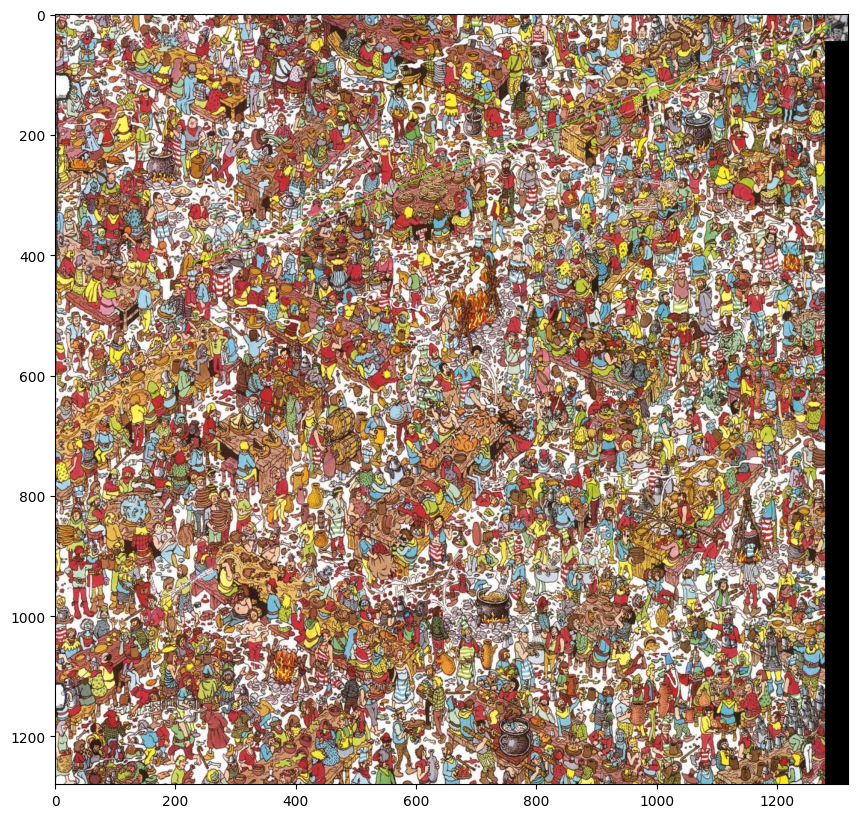

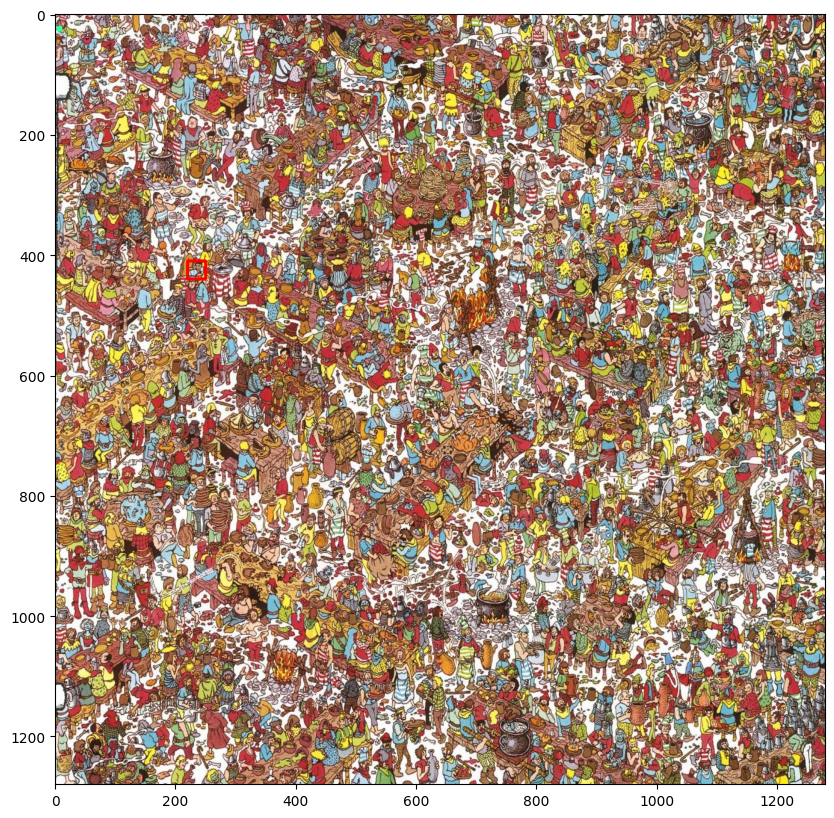

In [89]:

# Assuming des_1 and des_2, gray_img_scene, k_1, k_2, and template_scale are already defined

# Match descriptors using BFMatcher
bf = cv2.BFMatcher(cv2.NORM_L1)
matches = bf.knnMatch(des_1, des_2, k=2)

# Apply ratio test to find the best matches
good = []
for m, n in matches:
    if m.distance < 0.55 * n.distance:
        good.append(m)
# Ensure we have enough matches to find a homography
if len(good) > 2:
    # Extract the matching keypoints' locations
    src_pts = np.float32([k_1[m.queryIdx].pt for m in good]).reshape(-1, 1, 2)
    dst_pts = np.float32([k_2[m.trainIdx].pt for m in good]).reshape(-1, 1, 2)

    # Compute homography
    M, mask = cv2.findHomography(src_pts, dst_pts, cv2.RANSAC, 5.0)

    if M is not None:
        print("Homography matrix:\n", M)

        # Get the corners of the template
        h, w = template_scale.shape[:2]
        corners = np.float32([[0, 0], [0, h], [w, h], [w, 0]]).reshape(-1, 1, 2)

        # Transform the corners to the scene image
        transformed_corners = cv2.perspectiveTransform(corners, M)
        print("Transformed corners:\n", transformed_corners)

        # Ensure transformed_corners are valid for drawing
        if transformed_corners is not None and len(transformed_corners) > 0:
            # Flatten the corners for easier processing
            transformed_corners = transformed_corners.reshape(-1, 2)

            # Extract x and y coordinates
            x_min, y_min = np.min(transformed_corners, axis=0)
            x_max, y_max = np.max(transformed_corners, axis=0)

            # Print coordinates to debug
            print(f"x_min: {x_min}, y_min: {y_min}, x_max: {x_max}, y_max: {y_max}")

            # Make the bounding box bigger
            padding = 20
            x_min -= padding
            y_min -= padding
            x_max += padding
            y_max += padding

            # Ensure the coordinates are within image bounds
            x_min = max(0, int(x_min))
            y_min = max(0, int(y_min))
            x_max = min(gray_img_scene.shape[1], int(x_max))
            y_max = min(gray_img_scene.shape[0], int(y_max))

            print(f"Corrected coordinates after padding and bounds check: x_min={x_min}, y_min={y_min}, x_max={x_max}, y_max={y_max}")

            # Draw the rectangle on the scene image
            image_with_rectangle = cv2.rectangle(brg_scene.copy(), 
                                                 (220, 410), 
                                                 (250, 440), 
                                                 (0, 0, 255), 3)  # Red rectangle

            # Draw the corners to visualize them directly
            for corner in transformed_corners:
                cv2.circle(image_with_rectangle, (int(corner[0]), int(corner[1])), 5, (173, 255, 47), -1)  # Bright green

            # Draw matches for visualization
            image_with_knn_matches = cv2.drawMatchesKnn(brg_scene, k_1, template_scale, k_2, [[m] for m in good], None, flags=2)

            # Show the result
            plt.figure()
            plt.imshow(cv2.cvtColor(image_with_knn_matches, cv2.COLOR_BGR2RGB))
            plt.figure()
            plt.imshow(cv2.cvtColor(image_with_rectangle, cv2.COLOR_BGR2RGB))
            plt.show()
        else:
            print("Transformed corners are invalid")
    else:
        print("Homography could not be computed")
else:
    print("Not enough matches are found - {}/{}".format(len(good), 3))


In [78]:
print(k_1[matches[1].queryIdx].size)
matches = sorted(matches, key=lambda x: x.distance)
image_with_matches = cv2.drawMatches(gray_img_scene, k_1, template_scale, k_2, matches[:20], template_scale, flags=2)
plt.figure()
plt.imshow(cv2.cvtColor(image_with_matches, cv2.COLOR_BGR2RGB))

bf = cv2.BFMatcher(cv2.NORM_L1)
matches = bf.knnMatch(des_1, des_2, k=2)

# Лучшие пары особых точек отбираются с использованием теста отношения правдоподобия
good = []
for m, n in matches:
    if m.distance < 0.65 * n.distance:
        good.append([m])

# построим совпадения на изображении
image_with_knn_matches = cv2.drawMatchesKnn(gray_img_scene,k_1,template_scale,k_2,good[:200],None,flags=2)
plt.figure()
plt.imshow(cv2.cvtColor(image_with_knn_matches, cv2.COLOR_BGR2RGB))

points = np.array([(0, 0)])
for i in good:
    points = np.append(points, [k_1[i[0].queryIdx].pt], axis=0)

points = points[1:len(points)]

# Определяем ширину окна и запускаем алгоритм кластеризации
bandwidth = estimate_bandwidth(points, quantile=0.1)
ms = MeanShift(bandwidth=bandwidth, bin_seeding=False, cluster_all=False)
cl = ms.fit_predict(points)

# Формируем кластеры особых точек
labels_unique = np.unique(ms.labels_)
kp = []
for i in labels_unique:
    kp.append(points[cl==i])

# Определяем центры кластеров, но только если в кластере содержится более 10 точек
cen = []
for i in kp:
    if len(i)>10:
        cen.append(np.mean(i, axis=0).astype(np.uint16))

# Вокруг выделенных центров обводим прямоугольники с размерами шаблона
plot_img = brg_scene.copy()
h, w = template_scale.shape

for pt in cen:
    cv2.rectangle(plot_img, (pt[0] - w, pt[1] - h),(pt[0] + w, pt[1] + h),(0,255,255), 8)  

# Отображаем результат на графике
plt.figure()
plt.imshow(cv2.cvtColor(plot_img, cv2.COLOR_BGR2RGB))

AttributeError: 'tuple' object has no attribute 'queryIdx'